In [1]:
import os
from os import listdir
from os.path import isdir, join
from dust3r.training import build_dataset
import numpy as np

/home/kh775/.conda/envs/dust3r/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
train_dataset = "MegaScenesAugmented(data_dir='/share/phoenix/nfs06/S9/kh775/code/wsfm/scripts/data/keypoint_localization/data/', image_dir='/share/phoenix/nfs06/S9/kh775/dataset/megascenes_augmented_exhaustive/', split='train', resolution=[(512, 512)])"
batch_size = 2
data_loader_train = build_dataset(train_dataset, batch_size, num_workers=1, test=False)

Building Train Data loader for dataset
Loading image pairs...
96919 image pairs loaded
Train dataset length: 48459


In [3]:
import matplotlib.pyplot as plt
def reverse_ImgNorm(np_array):
    np_array = np_array * 0.5 + 0.5
    np_array *= 255.0
    np_array = np_array.clip(0, 255).astype(np.uint8)
    return np_array
def viz(view1, view2):
    for b in range(batch_size):
        img1 = view1["img"][b].permute(1, 2, 0).numpy()
        img2 = view2["img"][b].permute(1, 2, 0).numpy()
        plan_xys = view1["xys"][b]
        image_xys = view2["xys"][b]
        plt.figure(figsize=(12, 12))
        plt.subplot(121).imshow(reverse_ImgNorm(img1))
        plt.subplot(121).scatter(plan_xys[:,0], plan_xys[:,1], s=2)
        # plt.title(f"{img1.shape}, {view1['resolution']}")
        plt.subplot(122).imshow(reverse_ImgNorm(img2))
        plt.subplot(122).scatter(image_xys[:,0], image_xys[:,1], s=2)
        # plt.title(f"{img2.shape}, {view2['resolution']}")
        # plt.title(f"{view1['landmark']}-{view1['comp']}")
        plt.show()

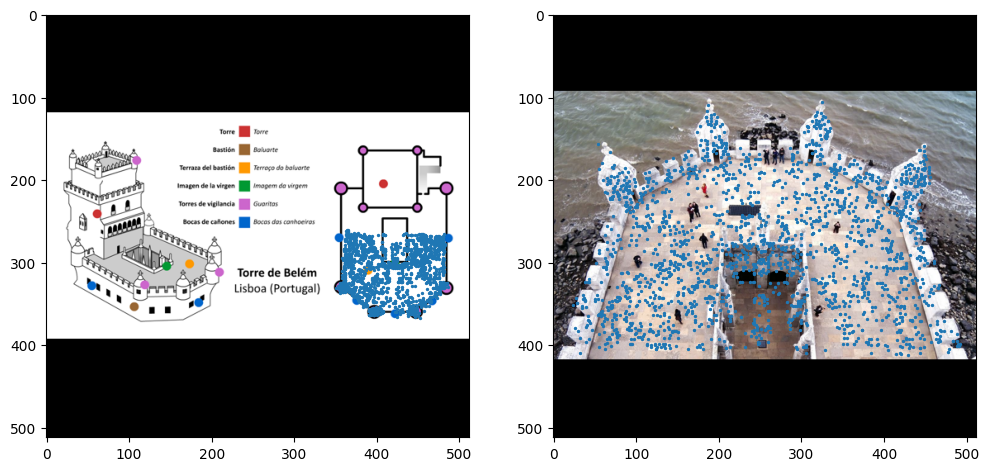

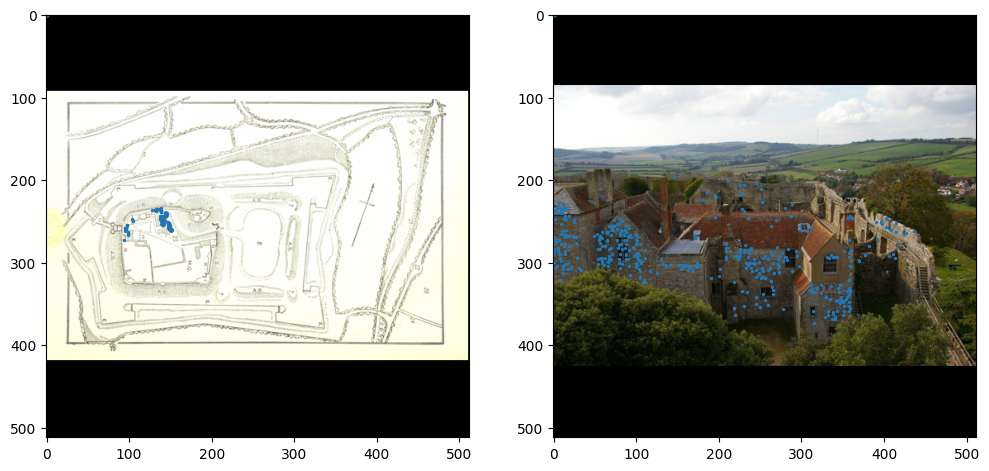

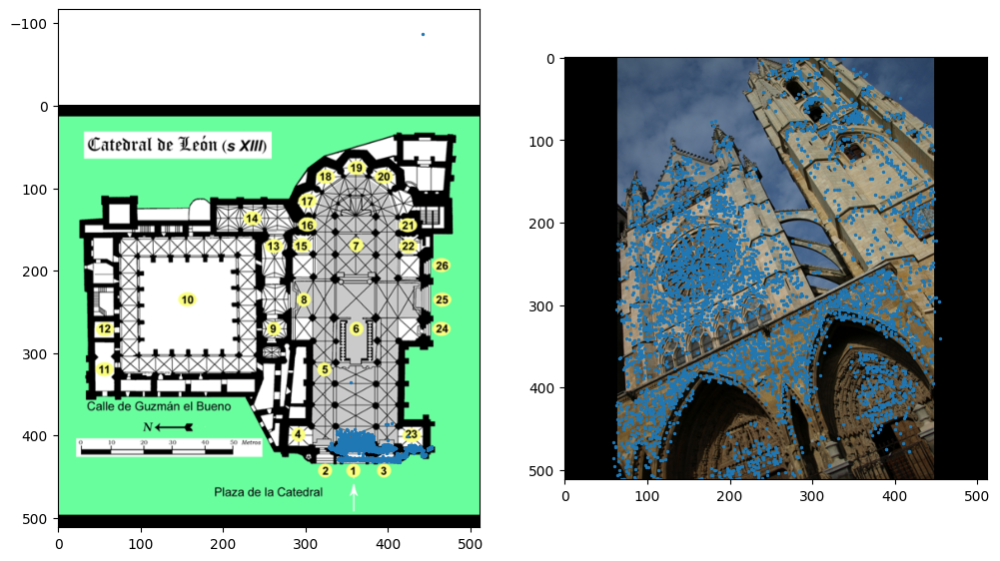

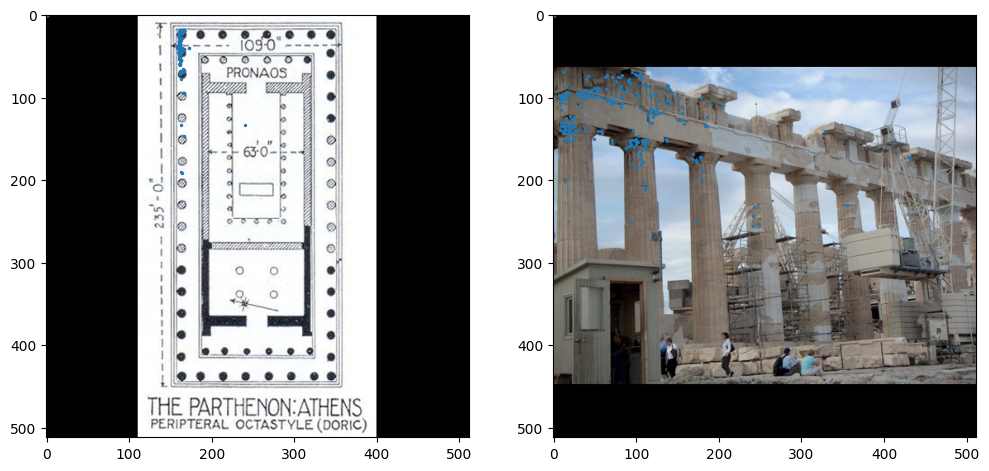

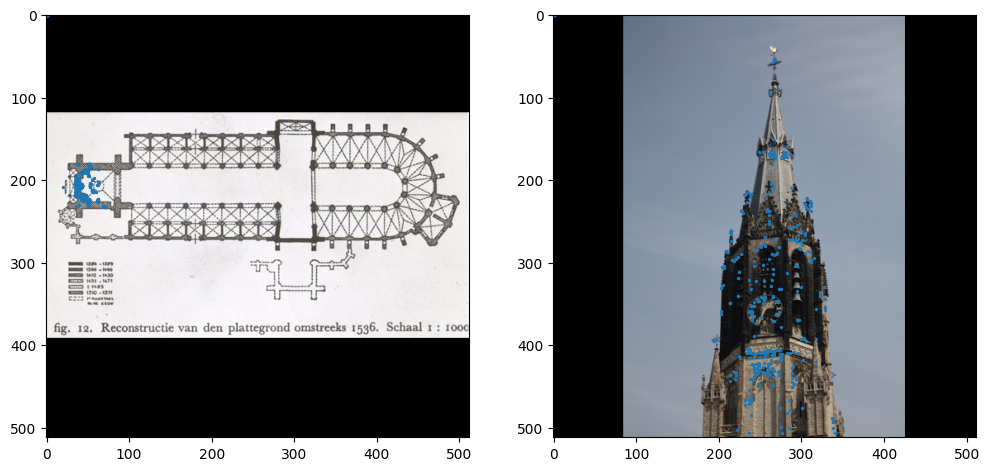

...

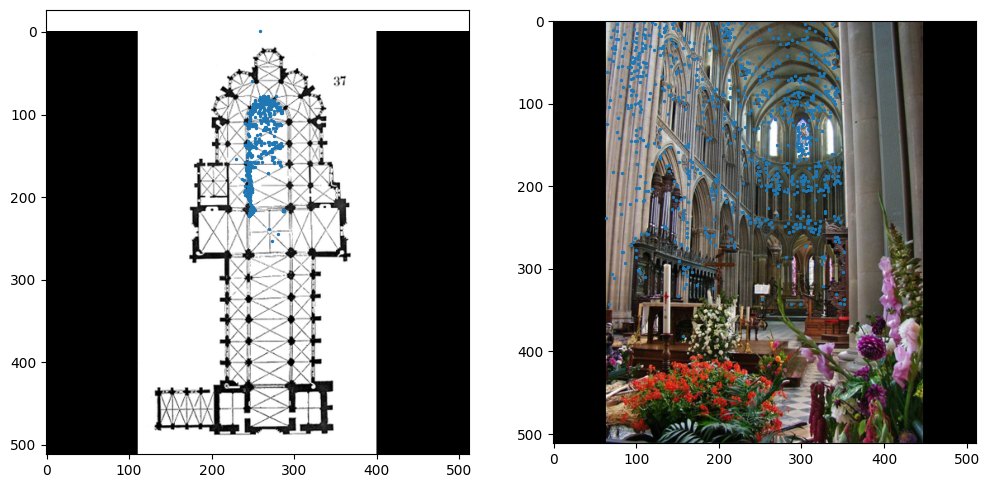

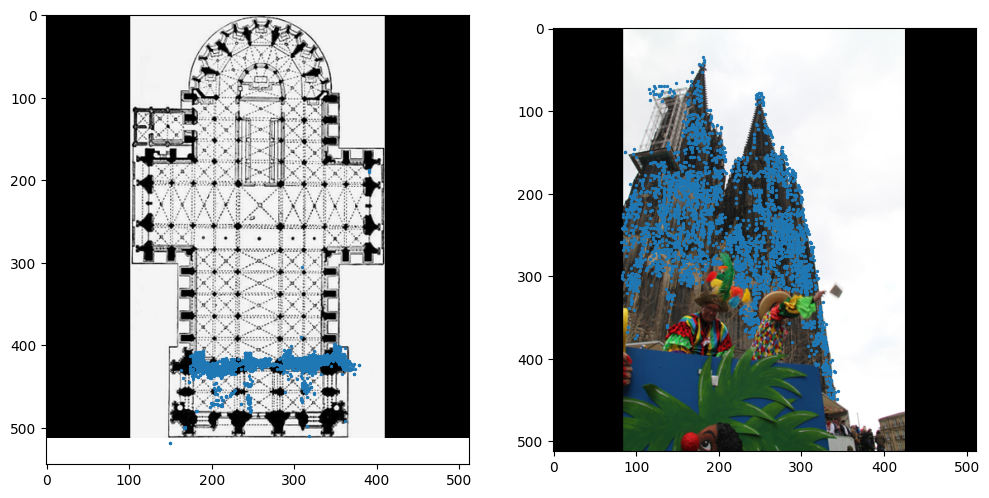

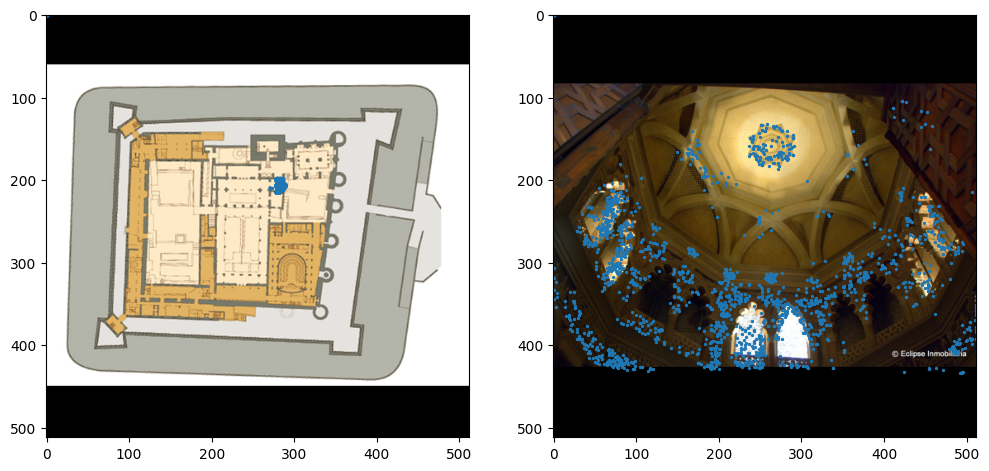

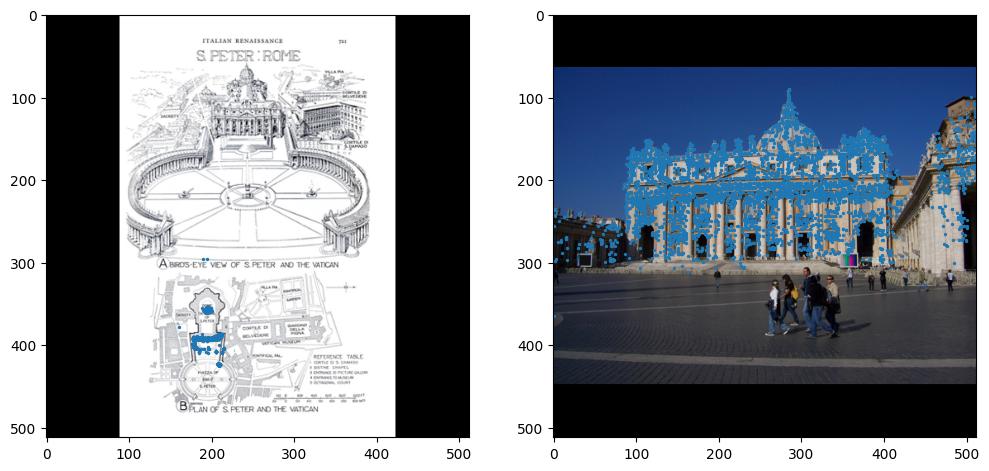

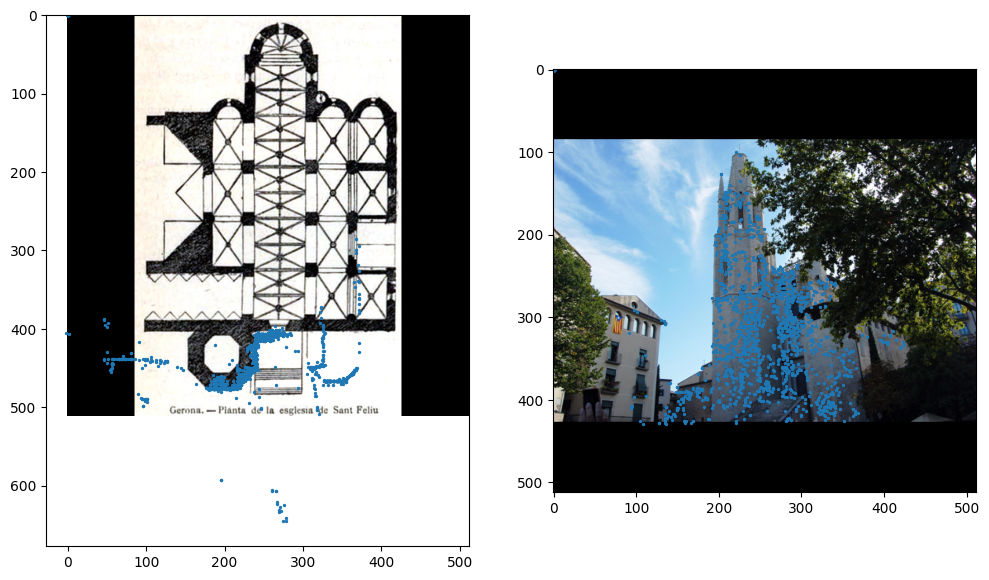

In [4]:
for i, b in enumerate(data_loader_train):
    if i < 32:
        view1, view2 = b
        viz(view1, view2)
    else:
        break